<a href="https://colab.research.google.com/github/sedaoturak/3D_Linear_Elasticity_FEniCS/blob/main/3D_Linear_Elasticity_Problem_FEniCS.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Install dependencies

pymsh: a Python interface for Gmsh, mesh generation tool
dolfin: the computational high-performance C++/Python backend of FEniCS

In [ ]:
try:
  import pygmsh
except:
  !pip install --upgrade --user gmsh
  !pip install pygmsh
  exit()  # the kernel must be restarted again!

In [ ]:
try:
    import dolfin
except ImportError:
    !wget "https://fem-on-colab.github.io/releases/fenics-install.sh" -O "/tmp/fenics-install.sh" && bash "/tmp/fenics-install.sh"
    import dolfin

In [ ]:
from fenics import *
import matplotlib.pyplot as plt
import numpy as np
import plotly.graph_objects as go

*The finite element problem is adopted from https://fenics-solid-tutorial.readthedocs.io/en/latest/2DPlaneStrain/2D_Elasticity.html*


#Define boundary

In [ ]:
# --------------------
# Functions and classes
# --------------------
def bottom(x, on_boundary):
    return (on_boundary and near(x[2], 0.0)) # def of which points will be included in bc at bottom surface

# Strain function
def epsilon(u):
    return sym(grad(u))

# Stress function
def sigma(u):
    return lambda_*div(u)*Identity(3) + 2*mu*epsilon(u)

In [ ]:
# --------------------
# Parameters
# --------------------

# Density (kg/m3)
rho = Constant(1240.0)

# Young's modulus (Pa) and Poisson's ratio
E = 33e6 # from Essentium TPU74D TDS
nu = 0.39 # from https://www.hindawi.com/journals/amse/2019/5838361/

# Lame's constants
lambda_ = E*nu/(1+nu)/(1-2*nu)
mu = E/2/(1+nu)

l_x, l_y, l_z = 40.0, 40.0, 20.0  # Domain dimensions
n_x, n_y = 40, 20  # Number of elements

# Load
g_z = -10000 # in N, applied load
b_z = -10 # in N, mass
g = Constant((0.0, 0.0, g_z))
b = Constant((0.0, 0.0, b_z))

# Model type
model = "plane_strain"
if model == "plane_stress":
    lambda_ = 2*mu*lambda_/(lambda_+2*mu)

In [ ]:
# Create the test sample with rad: 20mm, H: 20mm -cylinder
import pygmsh
rad = 20

with pygmsh.occ.Geometry() as geom:
    geom.characteristic_length_max=1

    cyl = geom.add_cylinder([20.0,20.0,0.0],[0.0,0.0,20.0], rad)

    mesh = geom.generate_mesh()

#mesh.write('sample.vtk')  # save to file

In [ ]:
import plotly.graph_objects as go
import pygmsh

x, y, z = mesh.points.T
i, j, k = mesh.cells_dict['triangle'].T

fig = go.Figure(data=[
    go.Mesh3d(
        x=x, y=y, z=z,
        i=i, j=j, k=k,
        showscale=True,name='y', 
        opacity=0.5   # make the mesh translucent
    )
])

fig.show()

In [ ]:
# from here: https://fenicsproject.discourse.group/t/pygmsh-tutorial/2506/3
import meshio
msh = mesh
# msh = meshio.read("mesh.msh")
for cell in msh.cells:
    if cell.type == "triangle":
        triangle_cells = cell.data
    elif  cell.type == "tetra":
        tetra_cells = cell.data

# only if data present:
# for key in msh.cell_data_dict["gmsh:physical"].keys():
#     if key == "triangle":
#         triangle_data = msh.cell_data_dict["gmsh:physical"][key]
#     elif key == "tetra":
#         tetra_data = msh.cell_data_dict["gmsh:physical"][key]

tetra_mesh = meshio.Mesh(points=msh.points, cells={"tetra": tetra_cells})

# only if triangles needed:
#triangle_mesh =meshio.Mesh(points=msh.points,
#                           cells=[("triangle", triangle_cells)],
#                           cell_data={"name_to_read":[triangle_data]})

meshio.write("mesh.xdmf", tetra_mesh)
#meshio.write("mf.xdmf", triangle_mesh)

In [ ]:
# --------------------
# Geometry
# --------------------
#from dolfin import *

mesh = Mesh()
filename = "mesh.xdmf"
f = XDMFFile(filename)
f.read(mesh)

In [ ]:
# --------------------
# Visualize mesh
# --------------------
verts = mesh.coordinates()
faces = mesh.cells()
tri_vertices = verts[faces]

Xe = []
Ye = []
Ze = []
for T in tri_vertices:
    Xe += [T[k%3][0] for k in range(4)] + [ None]
    Ye += [T[k%3][1] for k in range(4)] + [ None]
    Ze += [T[k%3][2] for k in range(4)] + [ None]
       
fig = go.Figure(data=[
    go.Scatter3d(x=Xe,
                     y=Ye,
                     z=Ze,
                     mode='lines',
                     name='',
                     line=dict(color= 'rgb(40,40,40)', width=0.5)
    )
])

fig.show()

In [ ]:
# Definition of Neumann boundary condition domain
boundaries = MeshFunction("size_t", mesh, mesh.topology().dim() - 1)
#boundaries.set_all(0)
# Neumann boundary conditions (top)
#top = AutoSubDomain(lambda x: near(x[2], 20.0))

#top.mark(boundaries, 1)
ds = ds(subdomain_data=boundaries)

In [ ]:
# --------------------
# Function spaces
# --------------------
V = VectorFunctionSpace(mesh, "CG", 1) # displacement function space
u_tr = TrialFunction(V)
u_test = TestFunction(V)

In [ ]:
def boundary_L(x, on_boundary):
    
    return on_boundary and near(x[0], 0)

bc_L = DirichletBC(V, Constant((0.0, 0.0, 0.0)), boundary_L)
#bc_L = DirichletBC(V.sub(0), 0.0, boundary_L)

In [ ]:
def boundary_R(x, on_boundary):
    
    return on_boundary and near(x[0], l_x)

bc_R = DirichletBC(V, Constant((0.0, 0.0, 0.0)), boundary_R)
#bc_R = DirichletBC(V.sub(0), 0.0, boundary_R)

In [ ]:
# --------------------
# Boundary conditions
# --------------------
#bc = DirichletBC(V, Constant((0.0, 0.0)), bottom)
bc = DirichletBC(V.sub(2), 0.0, bottom)

In [ ]:
# --------------------
# Weak form
# --------------------
a = inner(sigma(u_tr), epsilon(u_test))*dx
l = rho*dot(b, u_test)*dx + inner(g, u_test)*ds(1)

In [ ]:
# --------------------
# Solver
# --------------------
u = Function(V)
#bcs = [bc, bc_L, bc_R]
A_ass, L_ass = assemble_system(a, l, bc)

solve(A_ass, u.vector(), L_ass)

print(np.amax(u.vector()[:]))

0.11396384363329189


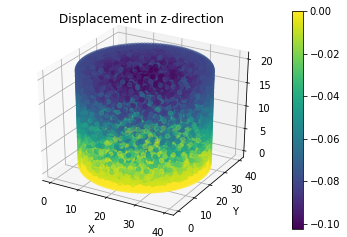

In [ ]:
# --------------------
# Plot Displacement in Z dir.
# --------------------
plt.figure()

c = plot(u.sub(2))
plt.colorbar(c)
plt.xlabel('X')
plt.ylabel('Y')
plt.title('Displacement in z-direction')
plt.show()

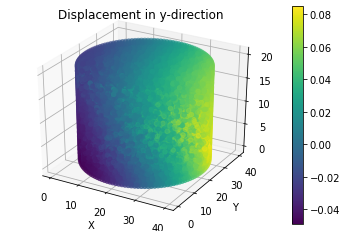

In [ ]:
# --------------------
# Plot Displacement in Y dir.
# --------------------
plt.figure()

c = plot(u.sub(1))
plt.colorbar(c)
plt.xlabel('X')
plt.ylabel('Y')
plt.title('Displacement in y-direction')
plt.show()

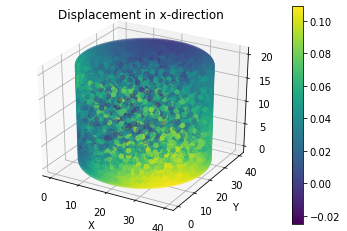

In [ ]:
# --------------------
# Plot Displacement in X dir.
# --------------------
plt.figure()

c = plot(u.sub(0))
plt.colorbar(c)
plt.xlabel('X')
plt.ylabel('Y')

plt.title('Displacement in x-direction')
plt.show()

In [ ]:
# --------------------
# Calculate stress
# --------------------

stress = sigma(u)


In [ ]:
# --------------------
# Project Stress
# --------------------
def local_project(fce, space):
    lp_trial, lp_test = TrialFunction(space), TestFunction(space)
    lp_a = inner(lp_trial, lp_test)*dx
    lp_L = inner(fce, lp_test)*dx
    local_solver = LocalSolver(lp_a, lp_L)
    local_solver.factorize() # caches the lhs
    lp_f = Function(space)
    local_solver.solve_local_rhs(lp_f)
    return lp_f

V0 = TensorFunctionSpace(mesh, "DG", 0)
stress_2 = local_project(stress, V0)

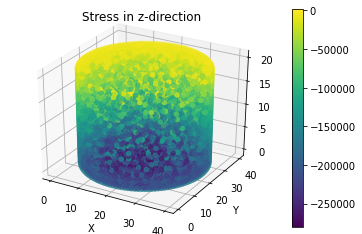

In [ ]:
# --------------------
# Plot Stress at Z dir.
# --------------------
plt.figure()
c = plot(stress_2[2, 2])
plt.colorbar(c)
plt.xlabel('X')
plt.ylabel('Y')
plt.title('Stress in z-direction')
plt.show()

Calling FFC just-in-time (JIT) compiler, this may take some time.


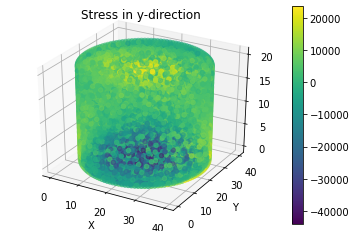

In [ ]:
# --------------------
# Plot Stress at Y dir.
# --------------------
plt.figure()
c = plot(stress_2[1, 1])
plt.colorbar(c)
plt.xlabel('X')
plt.ylabel('Y')
plt.title('Stress in y-direction')
plt.show()

Calling FFC just-in-time (JIT) compiler, this may take some time.


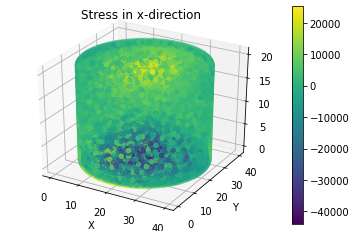

In [ ]:
# --------------------
# Plot Stress at X dir.
# --------------------
plt.figure()
c = plot(stress_2[0, 0])
plt.colorbar(c)
plt.xlabel('X')
plt.ylabel('Y')
plt.title('Stress in x-direction')
plt.show()

In [ ]:
# --------------------
# Calculate strain 
# --------------------
strain = epsilon(u)


In [ ]:
stress_2.vector()[:].shape

(1038150,)

In [ ]:
strain_project = local_project(strain, V0)

In [ ]:
strain_project.vector()[:]

array([ 1.94192195e-03, -1.62800930e-08, -1.89551806e-04, ...,
       -2.88102542e-05, -4.70857416e-05, -7.32067550e-03])

In [ ]:
strain_project.vector()[:].shape

(1038150,)

In [ ]:
strain_project.vector()[:].min()

-0.007419503279058685

In [ ]:
strain_values = strain_project.compute_vertex_values

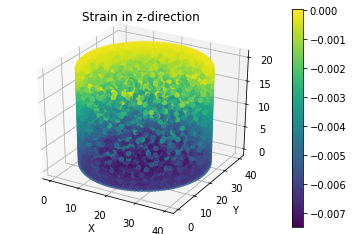

In [ ]:
# --------------------
# Plot strain at Z dir.
# --------------------

plt.figure()
c = plot(strain[2, 2])
plt.colorbar(c)
plt.xlabel('X')
plt.ylabel('Y')
plt.title('Strain in z-direction')
plt.show()

Calling FFC just-in-time (JIT) compiler, this may take some time.


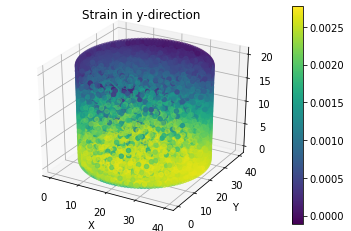

In [ ]:
# --------------------
# Plot strain at Y dir.
# --------------------

plt.figure()
c = plot(strain[1, 1])
plt.colorbar(c)
plt.xlabel('X')
plt.ylabel('Y')
plt.title('Strain in y-direction')
plt.show()

Calling FFC just-in-time (JIT) compiler, this may take some time.


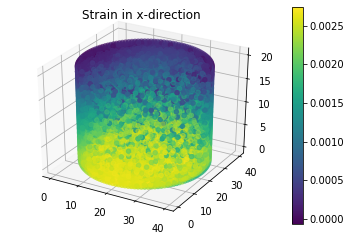

In [ ]:
# --------------------
# Plot strain at X dir.
# --------------------

plt.figure()
c = plot(strain[0, 0])
plt.colorbar(c)
plt.title('Strain in x-direction')
plt.show()

In [ ]:
# --------------------
# Calculate the average strain and stress
# --------------------
strain_xx = assemble(strain[0,0]*dx)

strain_yy = assemble(strain[1,1]*dx)

strain_zz = assemble(strain[2,2]*dx)

stress_xx = assemble(stress_2[0,0]*dx)

stress_yy = assemble(stress_2[1,1]*dx)

stress_zz = assemble(stress_2[2,2]*dx)

print("""Ave. stress in z-dir= {} MPa 
      \nAve. stress in y-dir= {} MPa 
      \nAve. stress in x-dir= {} MPa
      \nAve. strain in z-dir= {} 
      \nAve. strain in y-dir= {} 
      \nAve. strain in x-dir= {}""" .format(round(stress_zz/1e6,2), round(stress_yy/1e6, 2), round(stress_xx/1e6, 2),round(strain_zz,2),round(strain_yy,2),round(strain_xx,2)))

Ave. stress in z-dir= -3366.72 MPa 
      
Ave. stress in y-dir= -0.0 MPa 
      
Ave. stress in x-dir= 0.0 MPa
      
Ave. strain in z-dir= -102.02 
      
Ave. strain in y-dir= 39.79 
      
Ave. strain in x-dir= 39.79


Elastic Modulus: 33.0 MPa


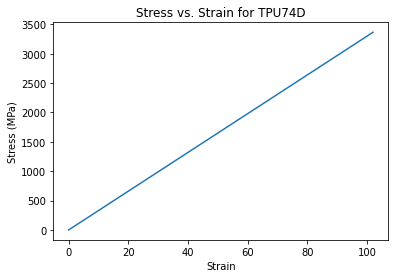

In [ ]:
# --------------------
# Calculate elastic modulus
# Plot stress vs. strain
# --------------------
x_axis = [0, np.abs(strain_zz)]
y_axis = [0, np.abs(stress_zz)/1e6] # in MPa

EM = round(np.abs(stress_zz)/np.abs(strain_zz)/1e6, 2) # in MPa
print('Elastic Modulus: {} MPa'. format(EM))

plt.plot(x_axis, y_axis)
plt.title('Stress vs. Strain for TPU74D')
plt.ylabel('Stress (MPa)')
plt.xlabel('Strain')
plt.show()

In [ ]:
# --------------------
# Calculation of Observed Elastic Modulus
# --------------------

EM = round((np.abs(g_z)/(3.14*np.power(rad,2)))/np.abs(strain_project.vector()[:].min()), 2) # 1 N/mm2 = 1 MPa
print('Elastic Modulus: {} MPa'. format(EM))


Elastic Modulus: 1073.09 MPa


*Code taken from https://www.ashwinsnayak.com/blog/20190528_blog_plotly_mesh/ashwin/*

In [ ]:
stress_values = stress_2.compute_vertex_values(mesh)

In [ ]:
# --------------------
# Plot deformed body
# --------------------
if not isinstance(mesh, dolfin.cpp.mesh.Mesh) :
    raise RuntimeError("Expecting DOLFIN Mesh as keyword argument")

# Get mesh vertices
vertices = mesh.coordinates()[:]

# Mark and extract Face Indices from the tetrahedral mesh
boundary_markers = dolfin.MeshFunction("size_t", mesh, mesh.topology().dim()-1, 0)
condition=None
if condition is None:
    condition = "on_boundary"
bnd = dolfin.CompiledSubDomain(condition)

bnd.mark(boundary_markers, 1)
face_indices = boundary_markers.where_equal(1) 

# Extract vertices which make the extracted faces
ijk = np.empty((3, len(face_indices)), dtype=np.int)
for iface, face in enumerate(face_indices) :
    face_info = dolfin.MeshEntity(mesh, 2, face)  # Pick info of the faces
    face_vertices = face_info.entities(0)    # Get vertices which make the face
    ijk[:, iface] = face_vertices

# Pick only vertices of relevant faces from the mesh-vertex list
_ivertices = np.unique(ijk.flatten())

# Add displacement values
gdim = mesh.topology().dim() 
nv = mesh.num_vertices() 
w0 = u.vector()[:]
U = [w0[i*nv: (i+1) *nv] for i in range(gdim)] 
X = mesh.coordinates() 
X = [X[:, i] for i in range(gdim)]
xdef = [X[i] + U[i] for i in range(gdim)]

x, y, z = xdef[0], xdef[1], xdef[2]
i, j, k = ijk

# Change values of i, j, k arrays to the new vertex list
for t in range(_ivertices.size):
  i[i == _ivertices[t]] = j[j == _ivertices[t]] = k[k == _ivertices[t]] = t    

fig = go.Figure()
fig.add_mesh3d(x=x, y=y, z=z,    # Vertex positions
                i=i, j=j, k=k,    # Connectivity info
                intensity = stress_values,
                flatshading=True,
                colorbar_title='Stress',
                colorscale=[[0, 'gold'],
                          [0.5, 'mediumturquoise'],
                          [1, 'magenta']],
                cmin=-30000,
                cmax=30000,

                name='y', showscale=True,
                opacity=0.5,  # make the mesh translucent
                )
# Show figure
fig.show()

In [ ]:
xdef[2].max()

20.084135934295045

In [ ]:
xdef[2].min()

-0.08690743020133779

In [ ]:
nodal_values_u=u.vector()[:]
nodal_values_u

array([ 0.04161522,  0.06067397, -0.06972105, ..., -0.01731235,
       -0.01305527,  0.        ])

In [ ]:
nodal_values_u.shape

(64380,)

In [ ]:
nodal_values_u.max()

0.10898597121300758

In [ ]:
nodal_values_u.min()

-0.09057407043063487

In [ ]:
vertex_values_u=u.compute_vertex_values()
vertex_values_u

array([ 0.0479383 ,  0.09395542,  0.04580306, ..., -0.04234514,
       -0.04837351, -0.0713786 ])

In [ ]:
vertex_values_u.shape

(64380,)

In [ ]:
vertex_values_u.max()

0.10898597121300758

In [ ]:
vertex_values_u.min()

-0.09057407043063487

In [ ]:
dof2vtx = vertex_to_dof_map(V0)

In [ ]:
dof2vtx.shape

(193140,)

*Old code*

In [ ]:
# --------------------
# Plot deformed body
# --------------------

import plotly.graph_objects as go

def mesh2triang(mesh):
  import matplotlib.tri as tri
  xyz = mesh.coordinates()#.T #mesh.points
  if mesh.cells().shape[1] > 3: print('running this'); triangles = mesh.cells()[:, :3]
  else:                         triangles = mesh.cells()
  return tri.Triangulation(xyz[:, 0], xyz[:, 1], triangles) 

In [ ]:
gdim = mesh.topology().dim() 
nv = mesh.num_vertices() 
w0 = u.compute_vertex_values(mesh) 
U = [w0[i*nv: (i+1) *nv] for i in range(gdim)] 
X = mesh.coordinates() 
X = [X[:, i] for i in range(gdim)]

In [ ]:
xdef = [X[i] + U[i] for i in range(gdim)]

In [ ]:
U[2]

array([-0.06359141,  0.        , -0.06362896, ..., -0.04052161,
       -0.04624183, -0.06775128])

In [ ]:
np.amin(U[2])

-0.08451356211879729

In [ ]:
# Plot the deformed body 
xy = mesh.coordinates()
x, y, z = xdef[0], xdef[1], xdef[2]
ijk = mesh2triang(mesh).triangles
i, j, k = ijk[:, 0], ijk[:, 1], ijk[:, 2] 

fig = go.Figure(data=[
    go.Mesh3d(
        x=x, y=y, z=z,
        # Intensity of each vertex, which will be interpolated and color-coded_rev
        intensity = stress_values,
        flatshading=True,
        colorbar_title='Stress',
        colorscale=[[0, 'gold'],
                    [0.5, 'mediumturquoise'],
                    [1, 'magenta']],
        cmin=-50000,
        cmax=50000,
        # i, j and k give the vertices of triangles
        # here we represent the 4 triangles of the tetrahedron surface
        i=i, j=j, k=k,
        name='y', showscale=True,
        opacity=0.5  # make the mesh translucent
    )
])

fig.show()

running this


In [ ]:
_ivertices

array([   0,    1,    2, ..., 5943, 5944, 5945])